In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Input, Concatenate, Conv2D, BatchNormalization, MaxPooling2D, Dropout, Conv2DTranspose
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score
import pickle
from sklearn.metrics import classification_report, confusion_matrix
import cv2

# Set random seeds for reproducibility
np.random.seed(42)
tf.random.set_seed(42)

# Data paths
BASE_DIR = "data"
MODEL_DIR = "models"
RESULTS_DIR = "results"
os.makedirs(MODEL_DIR, exist_ok=True)

# Constants
IMG_HEIGHT = 512
IMG_WIDTH = 512
NUM_CLASSES = 2  # Binary classification (nodule vs non-nodule)
BATCH_SIZE = 4

In [2]:
# Load data
def load_data():
    """Load the preprocessed data"""
    print("Loading preprocessed data...")
    
    X_train = np.load(os.path.join(BASE_DIR, "X_train.npy"))
    Y_train = np.load(os.path.join(BASE_DIR, "Y_train.npy"))
    attention_train = np.load(os.path.join(BASE_DIR, "attention_train.npy"))
    
    X_val = np.load(os.path.join(BASE_DIR, "X_val.npy"))
    Y_val = np.load(os.path.join(BASE_DIR, "Y_val.npy"))
    attention_val = np.load(os.path.join(BASE_DIR, "attention_val.npy"))
    
    # Load nodule coordinates
    with open(os.path.join(BASE_DIR, "coords_train.pkl"), 'rb') as f:
        coords_train = pickle.load(f)
    with open(os.path.join(BASE_DIR, "coords_val.pkl"), 'rb') as f:
        coords_val = pickle.load(f)
    
    # Convert labels to one-hot encoding for classification
    Y_train_onehot = tf.keras.utils.to_categorical(Y_train, NUM_CLASSES)
    Y_val_onehot = tf.keras.utils.to_categorical(Y_val, NUM_CLASSES)
    
    print(f"Training data: {X_train.shape[0]} samples")
    print(f"Validation data: {X_val.shape[0]} samples")
    print(f"Class distribution in training: {np.sum(Y_train == 0)} non-nodules, {np.sum(Y_train == 1)} nodules")
    print(f"Class distribution in validation: {np.sum(Y_val == 0)} non-nodules, {np.sum(Y_val == 1)} nodules")
    
    return X_train, Y_train_onehot, attention_train, X_val, Y_val_onehot, attention_val, coords_train, coords_val, Y_train, Y_val


X_train, Y_train_onehot, attention_train, X_val, Y_val_onehot, attention_val, coords_train, coords_val, Y_train_orig, Y_val_orig = load_data()

# Load segmentation masks
masks_train = np.load(os.path.join(BASE_DIR, "masks_train.npy"))
masks_val = np.load(os.path.join(BASE_DIR, "masks_val.npy"))

print(f"Image shape: {X_train.shape}")
print(f"Masks shape: {masks_train.shape}")
print(f"Attention masks shape: {attention_train.shape}")

Loading preprocessed data...
Training data: 123 samples
Validation data: 123 samples
Class distribution in training: 49 non-nodules, 74 nodules
Class distribution in validation: 44 non-nodules, 79 nodules
Image shape: (123, 512, 512, 1)
Masks shape: (123, 512, 512, 5)
Attention masks shape: (123, 512, 512, 1)


In [3]:
def create_augmented_dataset(X, Y, masks, attention, coords, 
                           multiplication_factor=2,
                           use_horizontal_flip=True,
                           use_rotation=True,
                           use_brightness=True,
                           use_zoom=True):
    import random
    import cv2
    
    print(f"Original dataset size: {len(X)} samples")
    
    # Calculate how many augmented versions to create per original sample
    aug_per_sample = multiplication_factor - 1
    
    # Initialize lists for augmented data
    X_aug = []
    Y_aug = []
    masks_aug = []
    attention_aug = []
    coords_aug = []
    
    # First add all original samples
    for i in range(len(X)):
        # Add original
        X_aug.append(X[i])
        Y_aug.append(Y[i])
        masks_aug.append(masks[i])
        attention_aug.append(attention[i])
        coords_aug.append(coords[i])
    
    # Then create augmented samples
    for i in range(len(X)):
        for j in range(aug_per_sample):
            # Start with copies of the original
            img = X[i].copy()
            label = Y[i]
            mask = masks[i].copy()
            att = attention[i].copy()
            coord = coords[i]
            
            # Track if coordinates should be updated
            modified = False
            
            # Get image dimensions for easier reference
            h, w = img.shape[0], img.shape[1]
            if len(img.shape) > 2:
                c = img.shape[2]  # Number of channels
            else:
                c = 1
                img = img.reshape(h, w, 1)
            
            # 1. Horizontal flip
            if use_horizontal_flip and random.random() > 0.5:
                img = np.flip(img, axis=1).copy()
                mask = np.flip(mask, axis=1).copy()
                att = np.flip(att, axis=1).copy()
                modified = True
                
                # Update coordinates for horizontal flip
                if coord is not None:
                    x, y = coord
                    # Flip x-coordinate (width - x)
                    x_flipped = w - x
                    coord = (x_flipped, y)
            
            # 2. Random rotation (small angles)
            if use_rotation and random.random() > 0.5:
                angle = random.uniform(-15, 15)
                center = (w//2, h//2)
                M = cv2.getRotationMatrix2D(center, angle, 1)
                
                # Apply rotation to image
                if c == 1:
                    # For single channel images
                    img_rotated = cv2.warpAffine(img.squeeze(), M, (w, h))
                    img = img_rotated.reshape(h, w, 1)
                else:
                    # For multi-channel images
                    img_rotated = cv2.warpAffine(img, M, (w, h))
                    img = img_rotated
                
                # Apply same rotation to masks (preserving all channels)
                if len(mask.shape) > 2:
                    # Multi-channel mask
                    rotated_masks = np.zeros_like(mask)
                    for ch in range(mask.shape[-1]):
                        rotated_masks[..., ch] = cv2.warpAffine(mask[..., ch], M, (w, h))
                    mask = rotated_masks
                else:
                    # Single channel mask
                    mask = cv2.warpAffine(mask, M, (w, h))
                
                # Apply rotation to attention mask
                if len(att.shape) > 2:
                    # Multi-channel attention
                    rotated_att = np.zeros_like(att)
                    for ch in range(att.shape[-1]):
                        rotated_att[..., ch] = cv2.warpAffine(att[..., ch], M, (w, h))
                    att = rotated_att
                else:
                    # Single channel attention
                    att = cv2.warpAffine(att, M, (w, h))
                
                modified = True
                
                # Update coordinates for rotation
                if coord is not None:
                    x, y = coord
                    # Apply rotation matrix to coordinates
                    x_rot = M[0, 0] * x + M[0, 1] * y + M[0, 2]
                    y_rot = M[1, 0] * x + M[1, 1] * y + M[1, 2]
                    coord = (x_rot, y_rot)
            
            # 3. Brightness/contrast adjustment (only to the image, not masks)
            if use_brightness and random.random() > 0.5:
                alpha = random.uniform(0.8, 1.2)  # Contrast
                beta = random.uniform(-0.1, 0.1)  # Brightness
                img = np.clip(alpha * img + beta, 0, 1)
                # Coordinates don't change for brightness adjustment
            
            # 4. Random zoom
            if use_zoom and random.random() > 0.5:
                zoom = random.uniform(0.9, 1.1)
                
                # Compute new dimensions
                new_h, new_w = int(h * zoom), int(w * zoom)
                
                # Handle zooming differently based on zoom factor
                if zoom > 1:  # Zoom in (crop)
                    # Calculate offsets
                    start_h = (new_h - h) // 2
                    start_w = (new_w - w) // 2
                    
                    # Resize and crop
                    if c == 1:
                        img_resized = cv2.resize(img.squeeze(), (new_w, new_h))
                        img = img_resized[start_h:start_h+h, start_w:start_w+w].reshape(h, w, 1)
                    else:
                        img_resized = cv2.resize(img, (new_w, new_h))
                        img = img_resized[start_h:start_h+h, start_w:start_w+w]
                    
                    # Handle masks based on their dimensionality
                    if len(mask.shape) > 2:
                        mask_resized = np.zeros((new_h, new_w, mask.shape[2]))
                        for ch in range(mask.shape[2]):
                            mask_resized[..., ch] = cv2.resize(mask[..., ch], (new_w, new_h))
                        mask = mask_resized[start_h:start_h+h, start_w:start_w+w]
                    else:
                        mask_resized = cv2.resize(mask, (new_w, new_h))
                        mask = mask_resized[start_h:start_h+h, start_w:start_w+w]
                    
                    # Handle attention masks based on their dimensionality
                    if len(att.shape) > 2:
                        att_resized = np.zeros((new_h, new_w, att.shape[2]))
                        for ch in range(att.shape[2]):
                            att_resized[..., ch] = cv2.resize(att[..., ch], (new_w, new_h))
                        att = att_resized[start_h:start_h+h, start_w:start_w+w]
                    else:
                        att_resized = cv2.resize(att, (new_w, new_h))
                        att = att_resized[start_h:start_h+h, start_w:start_w+w]
                    
                    # Update coordinates for zoom in
                    if coord is not None:
                        x, y = coord
                        # Apply zoom scaling and adjust for crop
                        x_zoomed = (x * zoom) - start_w
                        y_zoomed = (y * zoom) - start_h
                        coord = (x_zoomed, y_zoomed)
                
                else:  # Zoom out (pad)
                    # Calculate offsets
                    start_h = (h - new_h) // 2
                    start_w = (w - new_w) // 2
                    
                    # Create empty arrays and place resized content
                    if c == 1:
                        img_temp = np.zeros((h, w))
                        img_temp[start_h:start_h+new_h, start_w:start_w+new_w] = cv2.resize(img.squeeze(), (new_w, new_h))
                        img = img_temp.reshape(h, w, 1)
                    else:
                        img_temp = np.zeros((h, w, c))
                        img_temp[start_h:start_h+new_h, start_w:start_w+new_w] = cv2.resize(img, (new_w, new_h))
                        img = img_temp
                    
                    # Handle masks based on their dimensionality
                    if len(mask.shape) > 2:
                        mask_temp = np.zeros_like(mask)
                        for ch in range(mask.shape[2]):
                            ch_resized = cv2.resize(mask[..., ch], (new_w, new_h))
                            mask_temp[start_h:start_h+new_h, start_w:start_w+new_w, ch] = ch_resized
                        mask = mask_temp
                    else:
                        mask_temp = np.zeros_like(mask)
                        mask_temp[start_h:start_h+new_h, start_w:start_w+new_w] = cv2.resize(mask, (new_w, new_h))
                        mask = mask_temp
                    
                    # Handle attention masks based on their dimensionality
                    if len(att.shape) > 2:
                        att_temp = np.zeros_like(att)
                        for ch in range(att.shape[2]):
                            ch_resized = cv2.resize(att[..., ch], (new_w, new_h))
                            att_temp[start_h:start_h+new_h, start_w:start_w+new_w, ch] = ch_resized
                        att = att_temp
                    else:
                        att_temp = np.zeros_like(att)
                        att_temp[start_h:start_h+new_h, start_w:start_w+new_w] = cv2.resize(att, (new_w, new_h))
                        att = att_temp
                    
                    # Update coordinates for zoom out
                    if coord is not None:
                        x, y = coord
                        # Apply zoom scaling and adjust for padding
                        x_zoomed = (x * zoom) + start_w
                        y_zoomed = (y * zoom) + start_h
                        coord = (x_zoomed, y_zoomed)
                
                modified = True
            
            # Add augmented sample to the list
            X_aug.append(img)
            Y_aug.append(label)
            masks_aug.append(mask)
            attention_aug.append(att)
            coords_aug.append(coord)
    
    # Convert to numpy arrays (except coordinates)
    X_aug = np.array(X_aug)
    Y_aug = np.array(Y_aug)
    masks_aug = np.array(masks_aug)
    attention_aug = np.array(attention_aug)
    
    print(f"Augmented dataset size: {len(X_aug)} samples")
    print(f"Final shapes: X={X_aug.shape}, Y={Y_aug.shape}, masks={masks_aug.shape}, attention={attention_aug.shape}")
    
    return X_aug, Y_aug, masks_aug, attention_aug, coords_aug


X_train_aug, Y_train_orig_aug, masks_train_aug, attention_train_aug, coords_train_aug = create_augmented_dataset(
    X_train, Y_train_orig, masks_train, attention_train, coords_train,
    multiplication_factor=5,
    use_horizontal_flip=True,
    use_rotation=True,
    use_brightness=True,
    use_zoom=True
)

# Convert labels to one-hot
Y_train_onehot_aug = tf.keras.utils.to_categorical(Y_train_orig_aug, NUM_CLASSES)

Original dataset size: 123 samples
Augmented dataset size: 615 samples
Final shapes: X=(615, 512, 512, 1), Y=(615,), masks=(615, 512, 512, 5), attention=(615, 512, 512, 1)


In [4]:
def calculate_class_weights(Y):
    class_weights = {}
    total_samples = len(Y)
    for i in range(NUM_CLASSES):
        class_count = np.sum(Y == i)
        class_weights[i] = (total_samples / (NUM_CLASSES * class_count)) ** 2
    
    print(f"Class weights: {class_weights}")
    return class_weights

def weighted_categorical_crossentropy(class_weights):
    class_weights_tensor = tf.constant(list(class_weights.values()), dtype=tf.float32)
    
    def loss(y_true, y_pred):
        # Standard categorical crossentropy
        unweighted_loss = tf.keras.losses.categorical_crossentropy(y_true, y_pred)
        
        # Apply the weights
        weights = tf.reduce_sum(class_weights_tensor * y_true, axis=-1)
        weighted_loss = unweighted_loss * weights
        
        return tf.reduce_mean(weighted_loss)
    
    return loss

class_weights = calculate_class_weights(Y_train_orig_aug)
weighted_loss = weighted_categorical_crossentropy(class_weights)

Class weights: {0: 1.5752811328613077, 1: 0.6906957633308983}


In [5]:
def create_model():
    """Create a custom CNN that integrates images, segmentation masks, and attention guidance"""
    # Input layers
    img_input = Input(shape=(IMG_HEIGHT, IMG_WIDTH, 1), name='image_input')
    mask_input = Input(shape=(IMG_HEIGHT, IMG_WIDTH, 5), name='mask_input')
    
    # === IMAGE PATHWAY ===
    x = Conv2D(32, 3, padding='same', activation='relu')(img_input)
    x = BatchNormalization()(x)
    x = MaxPooling2D(2)(x)  # 256x256
    
    x = Conv2D(64, 3, padding='same', activation='relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(2)(x)  # 128x128
    
    x = Conv2D(128, 3, padding='same', activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.3)(x)
    
    # === MASK PATHWAY ===
    m = Conv2D(32, 3, padding='same', activation='relu')(mask_input)
    m = BatchNormalization()(m)
    m = MaxPooling2D(2)(m)  # 256x256
    
    m = Conv2D(64, 3, padding='same', activation='relu')(m)
    m = BatchNormalization()(m)
    m = MaxPooling2D(2)(m)  # 128x128
    
    m = Conv2D(128, 3, padding='same', activation='relu')(m)
    m = BatchNormalization()(m)
    
    # === COMBINE PATHWAYS ===
    combined = Concatenate()([x, m])  # 128x128x256
    combined = Conv2D(128, 3, padding='same', activation='relu')(combined)
    combined = BatchNormalization()(combined)
    combined = Dropout(0.3)(combined)
    
    # === CLASSIFICATION HEAD ===
    # Global pooling to get a single vector
    c = GlobalAveragePooling2D()(combined)
    c = Dense(64, activation='relu')(c)
    c = Dropout(0.5)(c)
    # Important: no reshape here, just a simple Dense layer with softmax
    classification_output = Dense(NUM_CLASSES, activation='softmax', name='classification')(c)
    
    # === LOCALIZATION HEAD ===
    # Upsample back to original size
    l = Conv2DTranspose(64, 3, strides=2, padding='same', activation='relu')(combined)
    l = BatchNormalization()(l)
    
    l = Conv2DTranspose(32, 3, strides=2, padding='same', activation='relu')(l)
    l = BatchNormalization()(l)
    
    localization_output = Conv2D(1, 1, activation='sigmoid', name='localization')(l)
    
    # Create model
    model = Model(
        inputs=[img_input, mask_input],
        outputs=[classification_output, localization_output]
    )
    
    # Compile with simpler configuration
    model.compile(
        optimizer=Adam(learning_rate=0.0001),
        loss={
            'classification': weighted_loss,
            'localization': 'binary_crossentropy'
        },
        metrics={
            'classification': 'accuracy',
            'localization': 'accuracy'
        }
    )
    
    return model

# Create model
model = create_model()
print(model.summary())

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 image_input (InputLayer)       [(None, 512, 512, 1  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 512, 512, 32  320         ['image_input[0][0]']            
                                )                                                                 
                                                                                                  
 mask_input (InputLayer)        [(None, 512, 512, 5  0           []                               
                                )]                                                            

In [6]:
def prepare_multipath_data(X, Y, masks, attention_masks):
    """Prepare data for multi-path model with careful handling of shapes"""
    # Convert labels to one-hot encoding if they're not already
    if len(Y.shape) == 1 or Y.shape[1] == 1:
        Y_onehot = tf.keras.utils.to_categorical(Y, NUM_CLASSES)
    else:
        Y_onehot = Y
    
    # Ensure attention masks have the right shape
    if len(attention_masks.shape) == 3:
        attention_masks = np.expand_dims(attention_masks, axis=-1)
    
    print(f"X shape: {X.shape}")
    print(f"Y_onehot shape: {Y_onehot.shape}")
    print(f"masks shape: {masks.shape}")
    print(f"attention_masks shape: {attention_masks.shape}")
    
    # Return in format expected by model
    return {
        'image_input': X,
        'mask_input': masks
    }, {
        'classification': Y_onehot,
        'localization': attention_masks
    }

def generator(inputs, outputs, batch_size=BATCH_SIZE, augment=True):
    """A simpler data generator that carefully preserves dimensions"""
    images = inputs['image_input']
    masks = inputs['mask_input']
    labels = outputs['classification']
    attention = outputs['localization']
    
    # Print shapes to verify
    print(f"Generator received: images={images.shape}, masks={masks.shape}, "
          f"labels={labels.shape}, attention={attention.shape}")
    
    num_samples = images.shape[0]
    indices = np.arange(num_samples)
    
    while True:
        np.random.shuffle(indices)
        
        for start_idx in range(0, num_samples, batch_size):
            end_idx = min(start_idx + batch_size, num_samples)
            batch_indices = indices[start_idx:end_idx]
            
            # Extract batch data
            batch_images = images[batch_indices].copy()
            batch_masks = masks[batch_indices].copy()
            batch_labels = labels[batch_indices].copy()
            batch_attention = attention[batch_indices].copy()
            
            # Only apply simple horizontal flip for augmentation to reduce issues
            if augment:
                for i in range(len(batch_indices)):
                    if np.random.random() < 0.5:  # 50% chance of flipping
                        # Flip image
                        batch_images[i] = np.flip(batch_images[i], axis=1)
                        
                        # Flip each mask channel
                        batch_masks[i] = np.flip(batch_masks[i], axis=1)
                        
                        # Flip attention mask
                        batch_attention[i] = np.flip(batch_attention[i], axis=1)
            
            # Package for model
            batch_inputs = {
                'image_input': batch_images,
                'mask_input': batch_masks
            }
            
            batch_outputs = {
                'classification': batch_labels,
                'localization': batch_attention
            }
            
            yield batch_inputs, batch_outputs

In [7]:
def train_model(X_train, Y_train, masks_train, attention_train, 
                X_val, Y_val, masks_val, attention_val, Y_train_orig):
    """Simplified training function with better error checking"""
    
    # Prepare data with careful shape handling
    print("Preparing training data...")
    train_inputs, train_outputs = prepare_multipath_data(X_train, Y_train, masks_train, attention_train)
    
    print("Preparing validation data...")
    val_inputs, val_outputs = prepare_multipath_data(X_val, Y_val, masks_val, attention_val)
    
    # Define callbacks
    callbacks = [
        ModelCheckpoint(
            os.path.join("models", 'best_multipath_model.h5'),
            monitor='val_classification_accuracy',
            save_best_only=True,
            mode='max',
            verbose=1
        ),
        EarlyStopping(
            monitor='val_classification_accuracy',
            patience=15,
            restore_best_weights=True,
            verbose=1
        ),
        ReduceLROnPlateau(
            monitor='val_classification_accuracy',
            factor=0.5,
            patience=5,
            min_lr=1e-7,
            verbose=1
        )
    ]
    
    # Train with simpler setup
    print("Starting training...")
    history = model.fit(
        generator(train_inputs, train_outputs, augment=True),
        steps_per_epoch=len(X_train) // BATCH_SIZE,
        epochs=50,
        validation_data=generator(val_inputs, val_outputs, augment=False),
        validation_steps=max(len(X_val) // BATCH_SIZE, 1),
        callbacks=callbacks,
        verbose=1
    )
    
    # Plot training history
    plt.figure(figsize=(12, 5))
    
    plt.subplot(1, 2, 1)
    plt.plot(history.history['classification_accuracy'])
    plt.plot(history.history['val_classification_accuracy'])
    plt.title('Classification Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='lower right')
    
    plt.subplot(1, 2, 2)
    plt.plot(history.history['classification_loss'])
    plt.plot(history.history['val_classification_loss'])
    plt.title('Classification Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper right')
    
    plt.tight_layout()
    plt.savefig(os.path.join("results", 'multipath_training_history.png'))
    plt.show()

    return history

In [8]:
def visualize_results(model, X_val, Y_val, masks_val, coords_val, attention_val, num_examples=5):
    """Visualize classification and localization results from the custom model"""
    print("\nVisualizing multi-path model results...")
    
    # Prepare validation data
    val_inputs = {'image_input': X_val, 'mask_input': masks_val}
    
    # Make predictions
    [class_pred, loc_pred] = model.predict(val_inputs)
    Y_pred = np.argmax(class_pred, axis=1)
    
    # Calculate metrics
    class_acc = np.mean(Y_pred == Y_val)
    print(f"Classification accuracy: {class_acc:.4f}")
    
    # Sample from different categories
    correct_positives = np.where((Y_pred == 1) & (Y_val == 1))[0]
    incorrect_positives = np.where((Y_pred == 0) & (Y_val == 1))[0]
    correct_negatives = np.where((Y_pred == 0) & (Y_val == 0))[0]
    incorrect_negatives = np.where((Y_pred == 1) & (Y_val == 0))[0]
    
    categories = [
        ("True Positives", correct_positives),
        ("False Negatives", incorrect_positives),
        ("True Negatives", correct_negatives),
        ("False Positives", incorrect_negatives)
    ]
    
    for title, indices in categories:
        print(f"\n{title}:")
        category_dir = os.path.join(RESULTS_DIR, f"multipath_{title.lower().replace(' ', '_')}")
        os.makedirs(category_dir, exist_ok=True)
        
        for i, idx in enumerate(indices[:min(num_examples, len(indices))]):
            # Create visualization
            fig, axes = plt.subplots(1, 4, figsize=(20, 5))
            
            # Original image
            axes[0].imshow(X_val[idx].squeeze(), cmap='gray')
            axes[0].set_title("Original X-ray")
            if coords_val[idx]:
                x, y = coords_val[idx]
                x_scaled = int(x * X_val.shape[1] / 2048)
                y_scaled = int(y * X_val.shape[2] / 2048)
                axes[0].scatter(x_scaled, y_scaled, c='red', marker='x', s=100)
            axes[0].axis('off')
            
            # Lung mask overlay
            lung_mask = masks_val[idx,:,:,2] + masks_val[idx,:,:,4]  # left + right lung
            axes[1].imshow(X_val[idx].squeeze(), cmap='gray')
            axes[1].imshow(lung_mask, alpha=0.3, cmap='Blues')
            axes[1].set_title("Lung Segmentation")
            axes[1].axis('off')
            
            # Ground truth attention mask
            axes[2].imshow(X_val[idx].squeeze(), cmap='gray')
            axes[2].imshow(attention_val[idx].squeeze(), alpha=0.5, cmap='hot')
            axes[2].set_title("Ground Truth Location")
            axes[2].axis('off')
            
            # Predicted localization
            axes[3].imshow(X_val[idx].squeeze(), cmap='gray')
            axes[3].imshow(loc_pred[idx].squeeze(), alpha=0.5, cmap='hot')
            axes[3].set_title(f"Predicted: {'Nodule' if Y_pred[idx] == 1 else 'Non-nodule'}")
            axes[3].axis('off')
            
            plt.tight_layout()
            plt.savefig(os.path.join(category_dir, f"example_{i+1}.png"))
            plt.close(fig)
            
            # Calculate localization metrics if this is a positive case
            if Y_val[idx] == 1:
                # IoU between prediction and ground truth
                threshold = 0.5
                pred_binary = loc_pred[idx].squeeze() > threshold
                true_binary = attention_val[idx].squeeze() > threshold
                
                intersection = np.sum(pred_binary & true_binary)
                union = np.sum(pred_binary | true_binary)
                iou = intersection / union if union > 0 else 0
                
                print(f"  Example {i+1}: IoU = {iou:.4f}")
    
    return class_acc


In [9]:
# Check if pretrained model exists
model_path = os.path.join(MODEL_DIR, 'best_model.h5')

if os.path.exists(model_path):
    print(f"Loading pretrained multi-path model from {model_path}")
    model = tf.keras.models.load_model(model_path, compile=False)
    # Need to recompile with custom metric
    model.compile(
        optimizer=Adam(learning_rate=0.0001),
        loss={
            'classification': 'categorical_crossentropy',
            'localization': 'binary_crossentropy'
        },
        metrics={
            'classification': 'accuracy',
            'localization': 'accuracy'
        }
    )
else:
    # Train multi-path model
    with tf.device('/GPU:0'):
        train_model(
            X_train_aug, Y_train_onehot_aug, masks_train_aug, attention_train_aug,
            X_val, Y_val_onehot, masks_val, attention_val,
            Y_train_orig_aug
        )
    model.save(model_path)

# Evaluate and visualize results
visualize_results(
    model, X_val, Y_val_orig, masks_val, coords_val, attention_val
)

Loading pretrained multi-path model from models\best_model.h5

Visualizing multi-path model results...
4/4 [==============================] - 20s 2s/step
Classification accuracy: 0.7805

True Positives:
  Example 1: IoU = 0.0000
  Example 2: IoU = 0.0000
  Example 3: IoU = 0.0000
  Example 4: IoU = 0.0000
  Example 5: IoU = 0.0000

False Negatives:
  Example 1: IoU = 0.0000
  Example 2: IoU = 0.0000
  Example 3: IoU = 0.0000
  Example 4: IoU = 0.0000
  Example 5: IoU = 0.0000

True Negatives:

False Positives:


0.7804878048780488


Evaluating classification performance...
4/4 [==============================] - 3s 909ms/step
Classification Report:
              precision    recall  f1-score   support

  Non-nodule       0.79      0.52      0.63        44
      Nodule       0.78      0.92      0.84        79

    accuracy                           0.78       123
   macro avg       0.78      0.72      0.74       123
weighted avg       0.78      0.78      0.77       123

Confusion Matrix:
[[23 21]
 [ 6 73]]


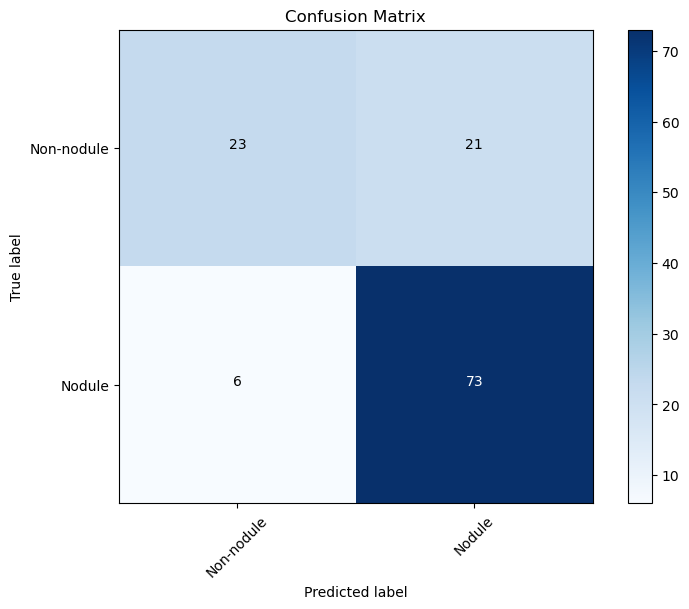

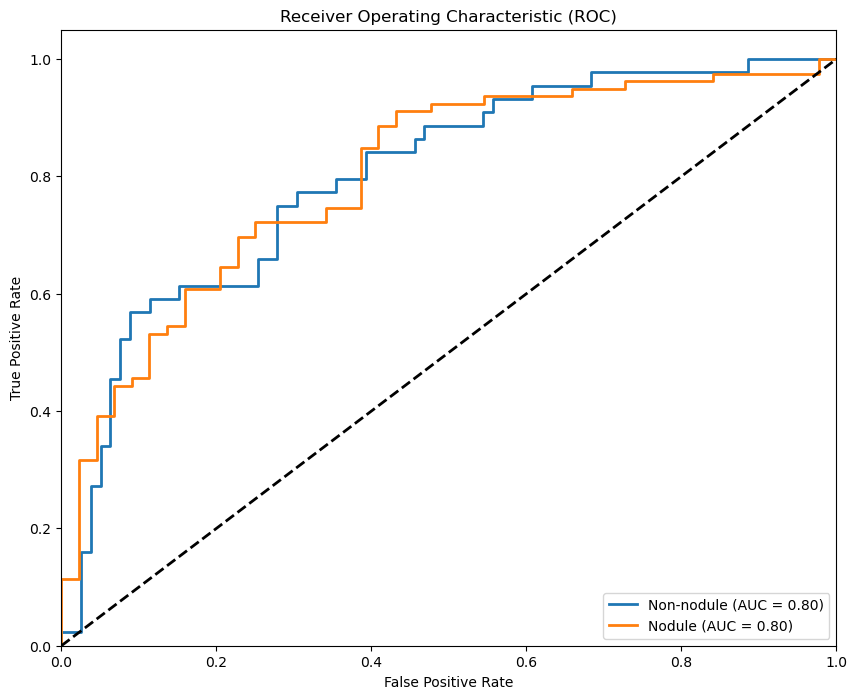

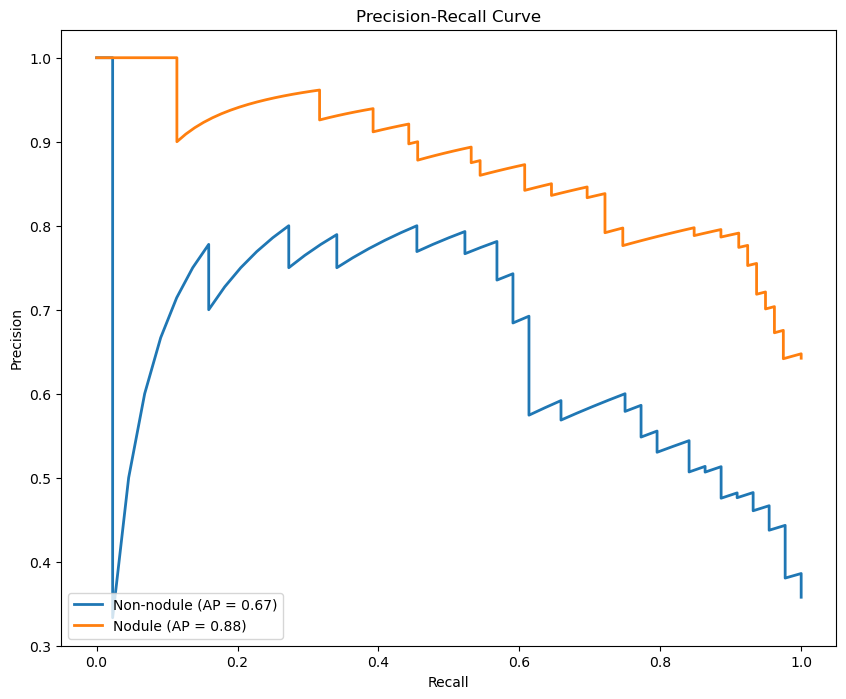

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1,
       1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0,
       1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0], dtype=int64)

In [10]:
def evaluate_classification_performance(model, X_val, Y_val, Y_val_orig, masks_val):
    """Evaluate the classification model performance"""
    print("\nEvaluating classification performance...")
    
    # Make predictions with BOTH inputs
    val_inputs = {'image_input': X_val, 'mask_input': masks_val}
    outputs = model.predict(val_inputs)
    
    # Get the classification output (first output)
    Y_pred_prob = outputs[0]  
    Y_pred = np.argmax(Y_pred_prob, axis=1)
    
    # Print classification report
    print("Classification Report:")
    print(classification_report(Y_val_orig, Y_pred, target_names=['Non-nodule', 'Nodule']))
    
    # Print confusion matrix
    cm = confusion_matrix(Y_val_orig, Y_pred)
    print("Confusion Matrix:")
    print(cm)
    
    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title('Confusion Matrix')
    plt.colorbar()
    tick_marks = np.arange(NUM_CLASSES)
    plt.xticks(tick_marks, ['Non-nodule', 'Nodule'], rotation=45)
    plt.yticks(tick_marks, ['Non-nodule', 'Nodule'])
    
    # Add text annotations
    thresh = cm.max() / 2
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            plt.text(j, i, format(cm[i, j], 'd'),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")
    
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.savefig(os.path.join(RESULTS_DIR, 'confusion_matrix.png'))
    plt.show()
    
    # Create a custom ROC curve instead of using evaluate_model
    custom_plot_roc_curve(Y_pred_prob, Y_val_orig)
    
    return Y_pred

def custom_plot_roc_curve(y_pred_prob, y_true):
    """Custom ROC curve plotter that doesn't use the model directly"""
    n_classes = y_pred_prob.shape[1]
    class_names = ['Non-nodule', 'Nodule']
    
    plt.figure(figsize=(10, 8))
    
    for i in range(n_classes):
        # Compute ROC curve and ROC area
        fpr, tpr, _ = roc_curve(y_true == i, y_pred_prob[:, i])
        roc_auc = auc(fpr, tpr)
        
        plt.plot(
            fpr, tpr, lw=2,
            label=f'{class_names[i]} (AUC = {roc_auc:.2f})'
        )
    
    plt.plot([0, 1], [0, 1], 'k--', lw=2)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC)')
    plt.legend(loc="lower right")
    plt.savefig(os.path.join(RESULTS_DIR, 'roc_curve.png'))
    plt.show()
    
    # Also create precision-recall curve
    plt.figure(figsize=(10, 8))
    
    for i in range(n_classes):
        precision, recall, _ = precision_recall_curve(y_true == i, y_pred_prob[:, i])
        avg_precision = average_precision_score(y_true == i, y_pred_prob[:, i])
        
        plt.plot(
            recall, precision, lw=2,
            label=f'{class_names[i]} (AP = {avg_precision:.2f})'
        )
    
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend(loc="lower left")
    plt.savefig(os.path.join(RESULTS_DIR, 'pr_curve.png'))
    plt.show()


evaluate_classification_performance(model, X_val, Y_val_onehot, Y_val_orig, masks_val)


Visualizing Grad-CAM examples...
4/4 [==============================] - 3s 922ms/step

True Positives (correctly identified nodules):
Example 4


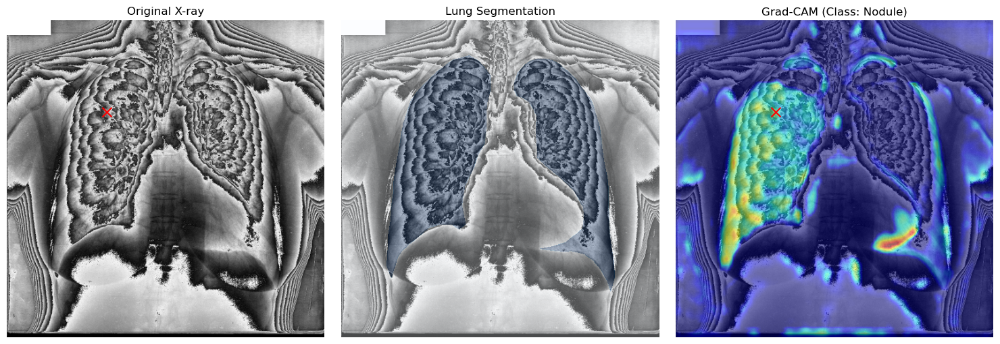

Example 68


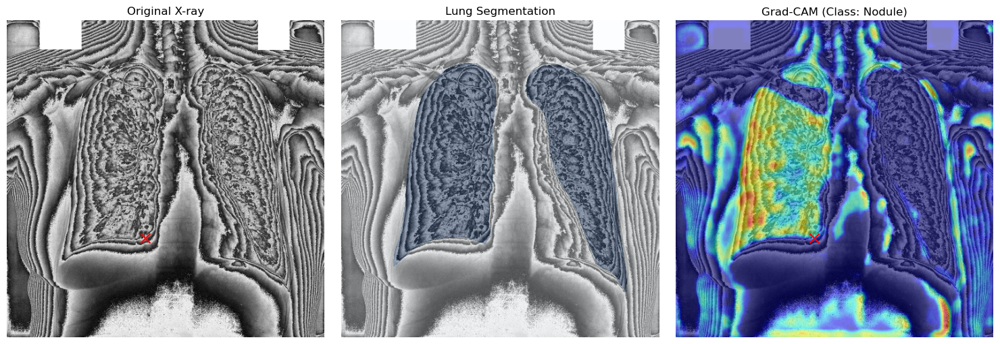

Example 18


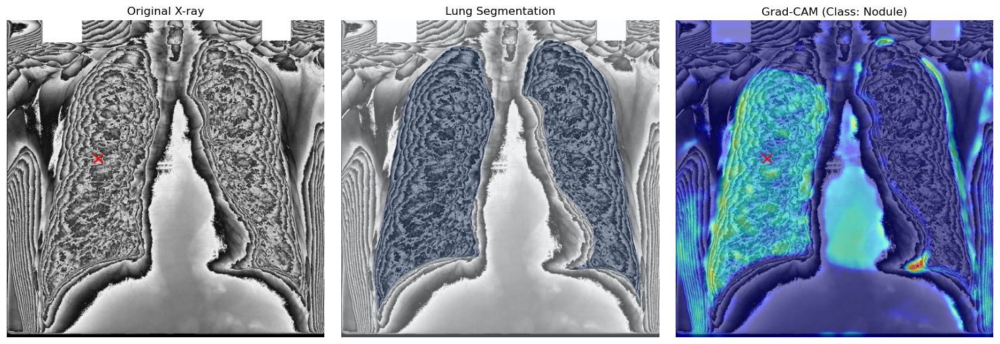

Example 0


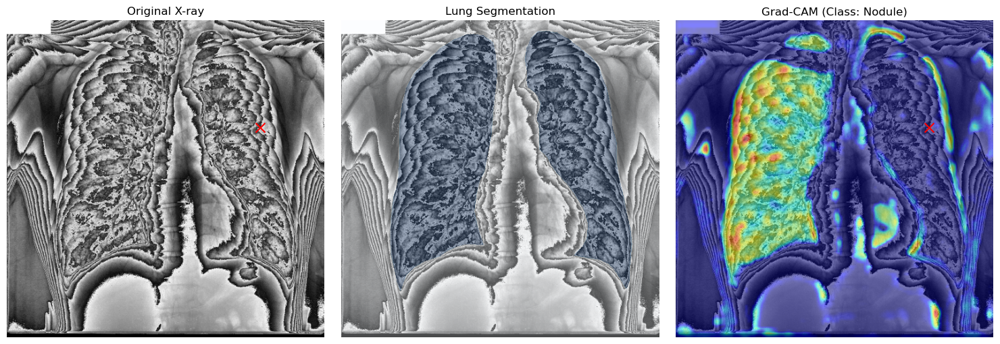

Example 28


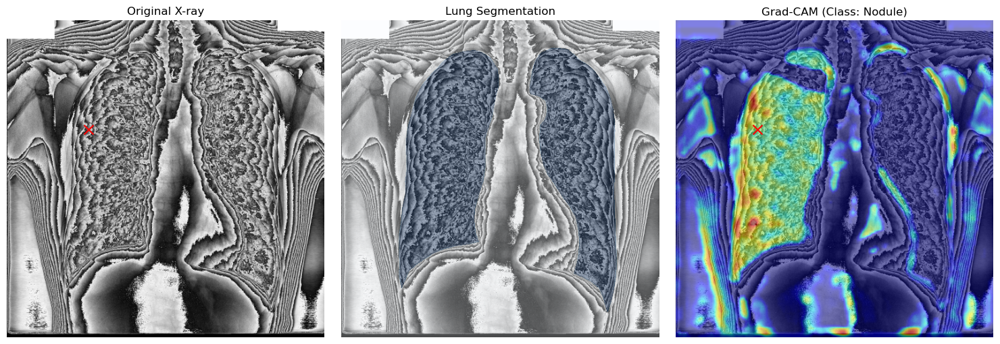


False Negatives (missed nodules):
Example 49


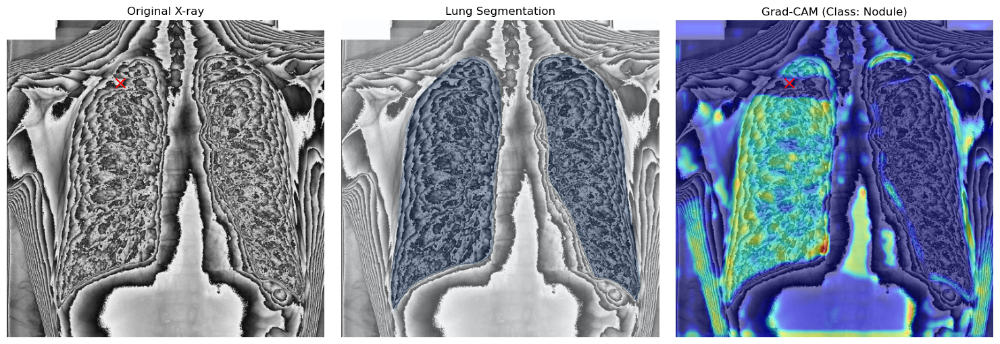

Example 29


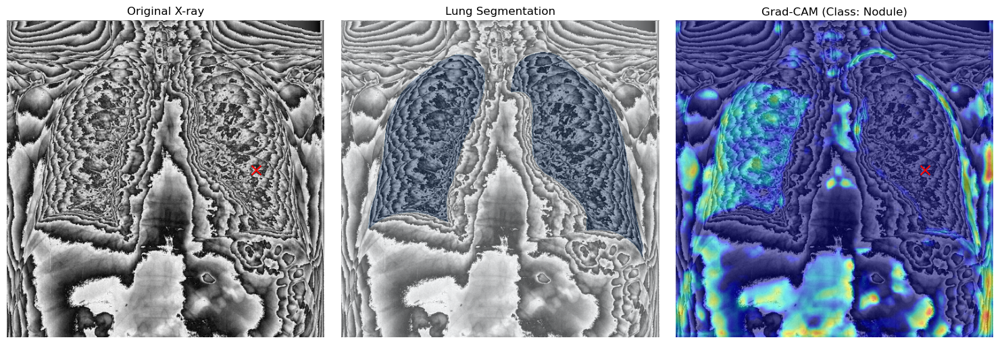

Example 44


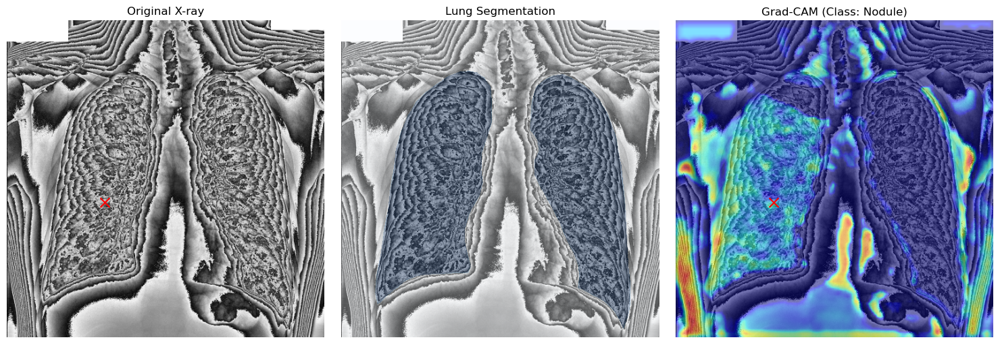

Example 35


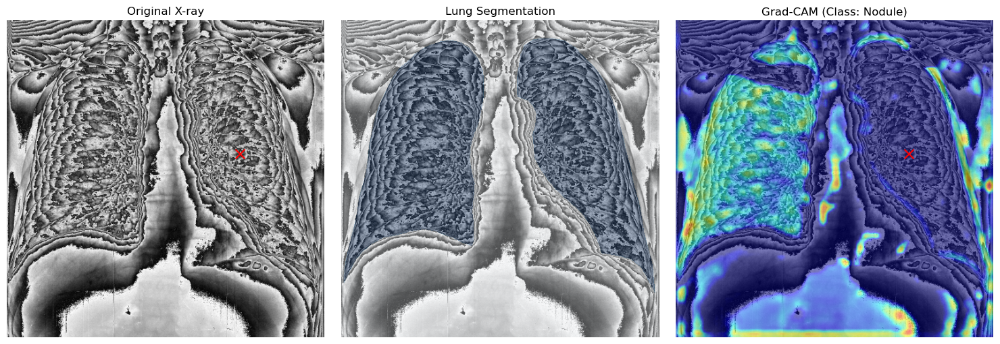

Example 77


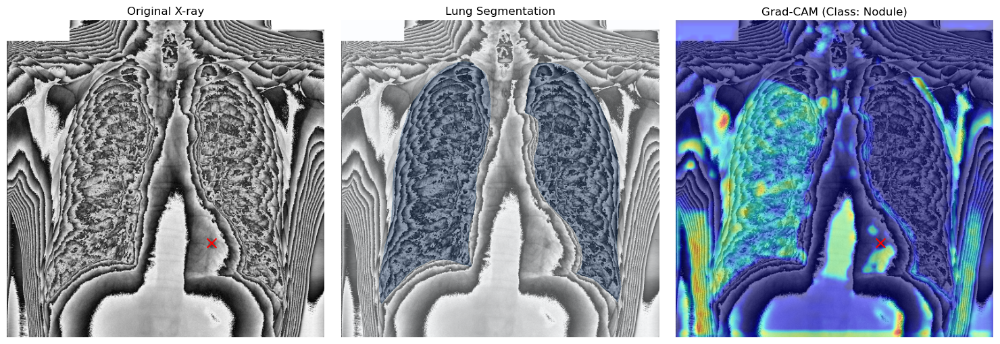


True Negatives (correctly identified non-nodules):
Example 85


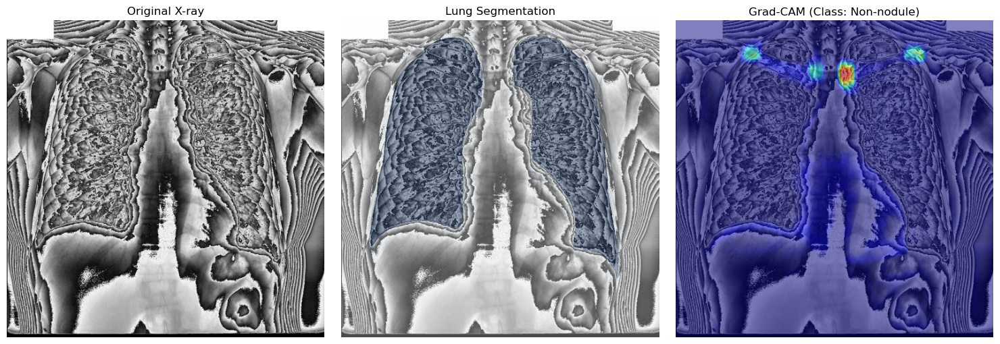

Example 80


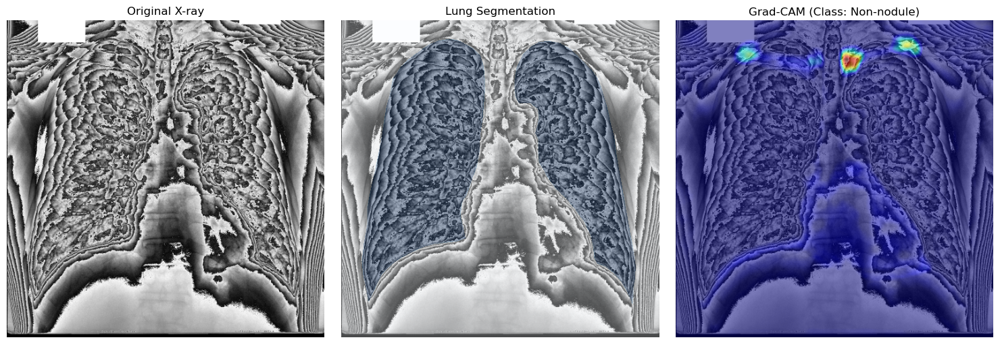

Example 89


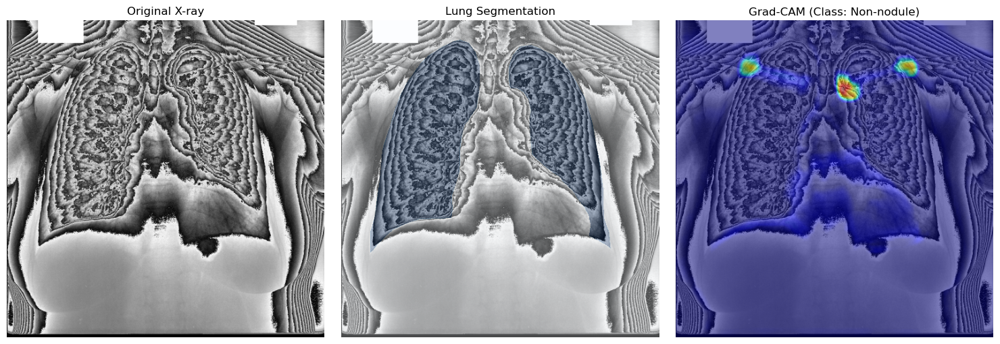

Example 91


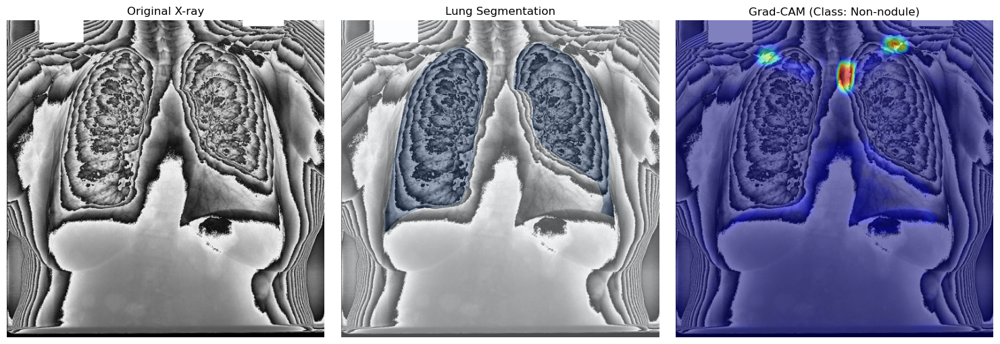

Example 109


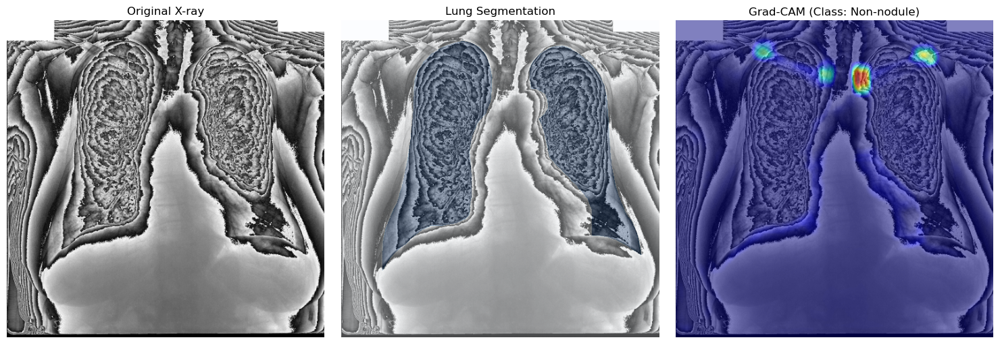


False Positives (incorrectly marked as nodules):
Example 110


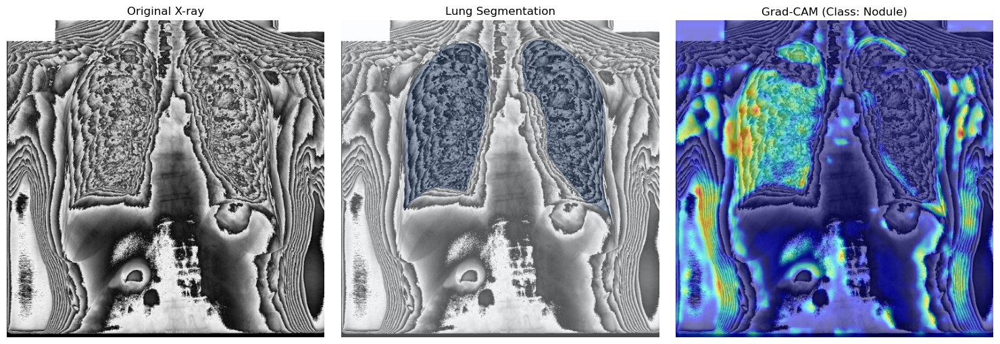

Example 105


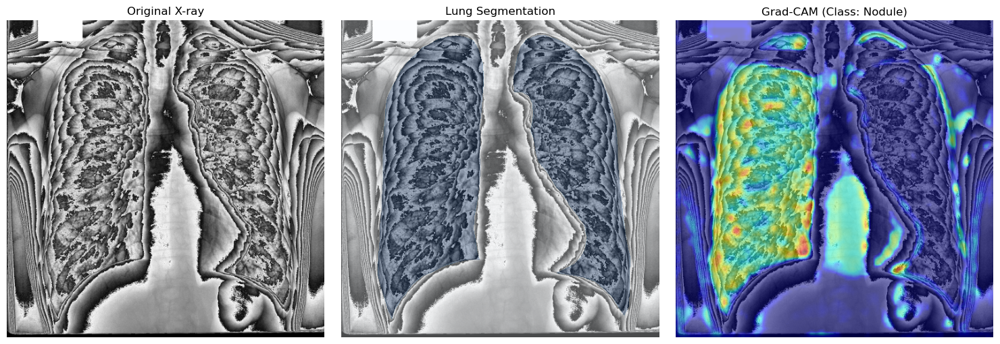

Example 101


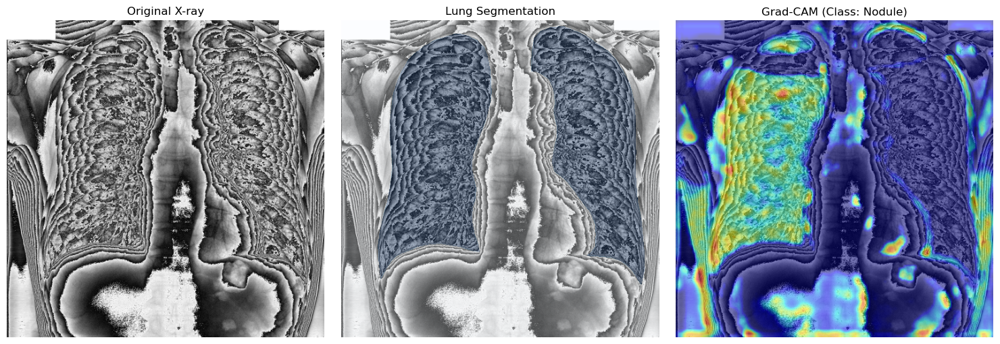

Example 108


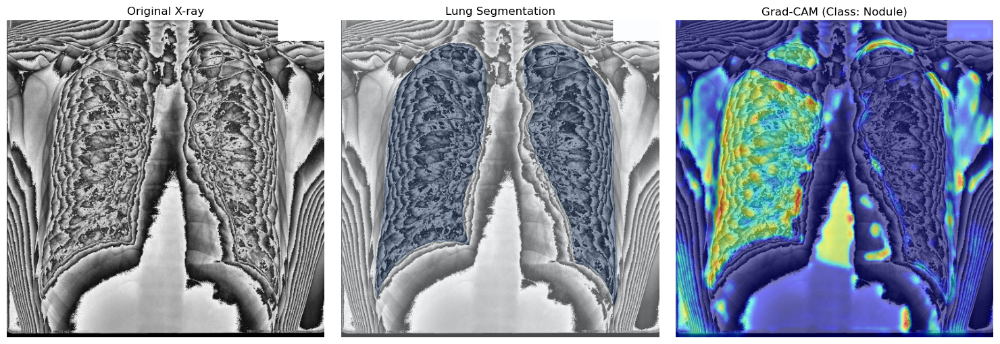

Example 112


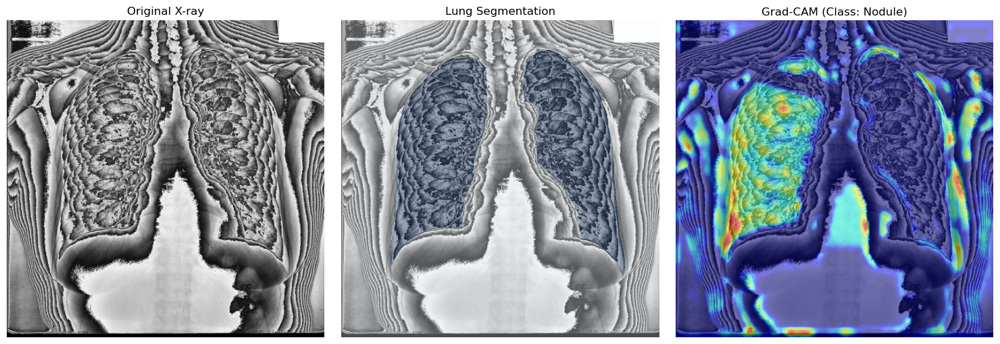

In [12]:
def custom_gradcam(model, img, mask, pred_class=None, layer_name='conv2d_6'):
    """Generate Grad-CAM heatmap for models with multiple inputs"""
    # Prepare inputs
    img_array = np.expand_dims(img, axis=0)
    mask_array = np.expand_dims(mask, axis=0)
    
    # Create model inputs
    inputs = {'image_input': img_array, 'mask_input': mask_array}
    
    # Get predictions if pred_class not specified
    if pred_class is None:
        preds = model.predict(inputs)
        pred_class = np.argmax(preds[0][0])
    
    # Create a model that outputs both the last conv layer and predictions
    grad_model = tf.keras.models.Model(
        inputs=model.inputs,
        outputs=[model.get_layer(layer_name).output, model.outputs[0]]
    )
    
    # Compute gradients
    with tf.GradientTape() as tape:
        conv_output, predictions = grad_model(inputs)
        class_score = predictions[:, pred_class]
    
    # Get gradients
    grads = tape.gradient(class_score, conv_output)
    
    # Global average pooling
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    
    # Multiply each channel by importance
    heatmap = tf.matmul(conv_output[0], pooled_grads[..., tf.newaxis])
    heatmap = tf.squeeze(heatmap)
    
    # Normalize heatmap
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    heatmap = heatmap.numpy()
    
    # Resize heatmap to match input image size
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    
    return heatmap

def visualize_gradcam_examples(model, X_val, Y_val_orig, coords_val, masks_val, num_examples=5):
    """Visualize Grad-CAM for a few examples"""
    print("\nVisualizing Grad-CAM examples...")
    
    # Get predictions with proper inputs
    val_inputs = {'image_input': X_val, 'mask_input': masks_val}
    outputs = model.predict(val_inputs)
    predictions = np.argmax(outputs[0], axis=1)
    
    # Get different categories of examples
    correct_positives = np.where((predictions == 1) & (Y_val_orig == 1))[0]
    incorrect_positives = np.where((predictions == 0) & (Y_val_orig == 1))[0]
    correct_negatives = np.where((predictions == 0) & (Y_val_orig == 0))[0]
    incorrect_negatives = np.where((predictions == 1) & (Y_val_orig == 0))[0]
    
    # Visualize examples from each category
    categories = [
        ("True Positives (correctly identified nodules)", correct_positives, 1),
        ("False Negatives (missed nodules)", incorrect_positives, 1),
        ("True Negatives (correctly identified non-nodules)", correct_negatives, 0),
        ("False Positives (incorrectly marked as nodules)", incorrect_negatives, 1)
    ]
    
    for title, indices, pred_class in categories:
        print(f"\n{title}:")
        # Create a directory for saving the visualizations
        category_dir = os.path.join(RESULTS_DIR, title.replace(" ", "_").lower())
        os.makedirs(category_dir, exist_ok=True)
        
        # Randomly select examples
        if len(indices) > num_examples:
            selected_indices = np.random.choice(indices, num_examples, replace=False)
        else:
            selected_indices = indices
            
        for i, idx in enumerate(selected_indices):
            print(f"Example {idx}")
            
            # Get the image and mask
            img = X_val[idx]
            mask = masks_val[idx]
            
            # Generate heatmap using custom_gradcam
            heatmap = custom_gradcam(model, img, mask, pred_class=pred_class, layer_name='conv2d_6')
            
            # Create visualization
            fig, axes = plt.subplots(1, 3, figsize=(15, 5))
            
            # Original image
            axes[0].imshow(img.squeeze(), cmap='gray')
            axes[0].set_title("Original X-ray")
            coords = coords_val[idx]
            if coords is not None:
                x, y = coords
                x_scaled = int(x * img.shape[1] / 2048)
                y_scaled = int(y * img.shape[0] / 2048)
                axes[0].scatter(x_scaled, y_scaled, c='red', marker='x', s=100)
            axes[0].axis('off')
            
            # Lung mask overlay
            lung_mask = mask[:,:,2] + mask[:,:,4]  # left + right lung
            axes[1].imshow(img.squeeze(), cmap='gray')
            axes[1].imshow(lung_mask, alpha=0.3, cmap='Blues')
            axes[1].set_title("Lung Segmentation")
            axes[1].axis('off')
            
            # Grad-CAM heatmap
            axes[2].imshow(img.squeeze(), cmap='gray')
            axes[2].imshow(heatmap, alpha=0.5, cmap='jet')
            axes[2].set_title(f"Grad-CAM (Class: {'Nodule' if pred_class == 1 else 'Non-nodule'})")
            if coords is not None:
                axes[2].scatter(x_scaled, y_scaled, c='red', marker='x', s=100)
            axes[2].axis('off')
            
            plt.tight_layout()
            plt.savefig(os.path.join(category_dir, f"example_{i+1}.png"))
            plt.show()

visualize_gradcam_examples(model, X_val, Y_val_orig, coords_val, masks_val)